### Laboratorium 6 - część 2/2

W tej części zajmiesz się wykorzystaniem punktów kluczowych do dwóch popularnych zadań: wyszukiwania obszarów podobnych oraz łączenia obrazów (_image stitching_).

Przeczytaj treść całej instrukcji przed przystąpieniem do działania!

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from utils import *
import os

#### Zadanie 3

Dane są obrazy `coke` i `table`. Wykorzystaj metodologię parowania punktów kluczowych do znalezienia wystąpienia puszki z Colą na stole. To zadanie jest podzielone na kilka kamieni milowych - czytaj dalej.

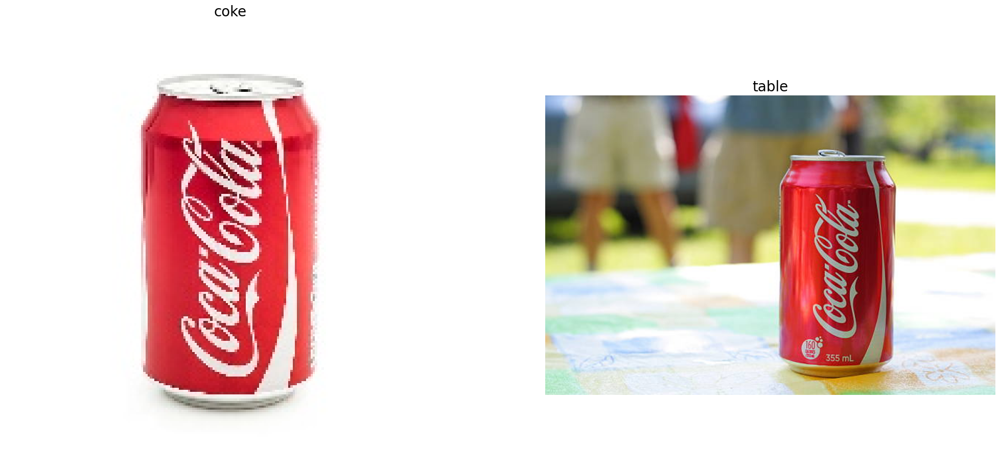

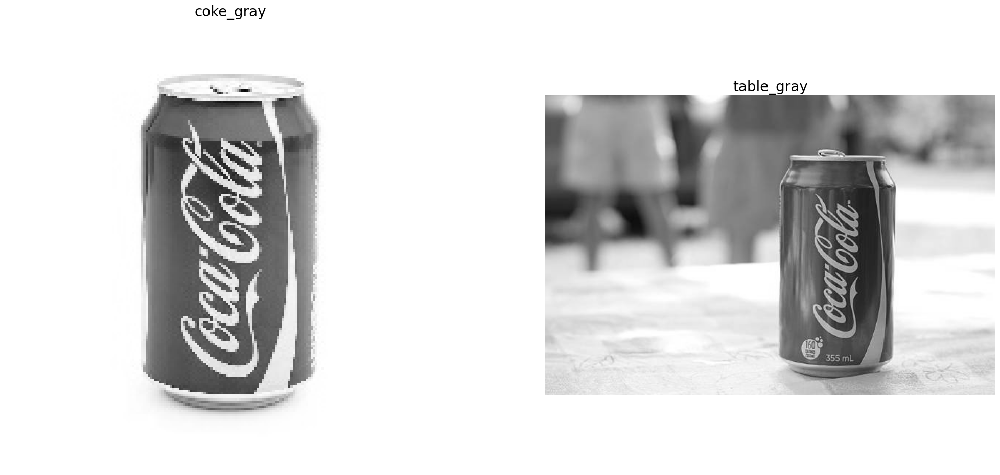

In [2]:
coke = cv2.imread('coke.jpg')
assert coke is not None
table = cv2.imread('coke-table.jpg')
assert table is not None
coke_gray = cv2.cvtColor(coke, cv2.COLOR_BGR2GRAY)
table_gray = cv2.cvtColor(table, cv2.COLOR_BGR2GRAY)
display_images([coke, table], ['coke', 'table'])
display_images([coke_gray, table_gray], ['coke_gray', 'table_gray'])

##### Zadanie 3a

Wykonaj detekcję punktów kluczowych i ich parowanie z użyciem dowolnego matchera. Wykonaj filtrację znalezionych par po dystansie - co obserwujesz, zmieniając próg?

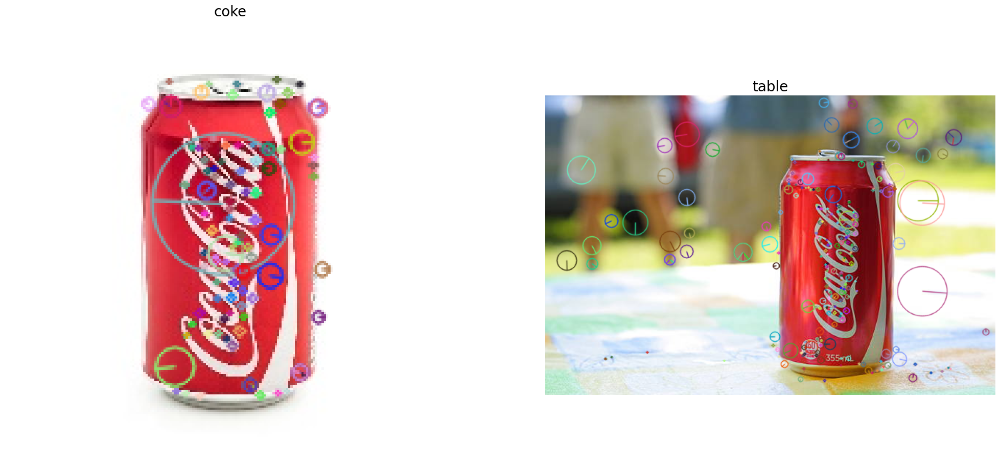

In [3]:
sift = cv2.SIFT_create()
coke_kp, coke_desc = sift.detectAndCompute(coke_gray, None)
table_kp, table_desc = sift.detectAndCompute(table_gray, None)

coke_kp_img = cv2.drawKeypoints(coke, coke_kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
table_kp_img = cv2.drawKeypoints(table, table_kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

display_images([coke_kp_img, table_kp_img], ['coke', 'table'])

## BRUTEFORCE - L2

Maches found:  65


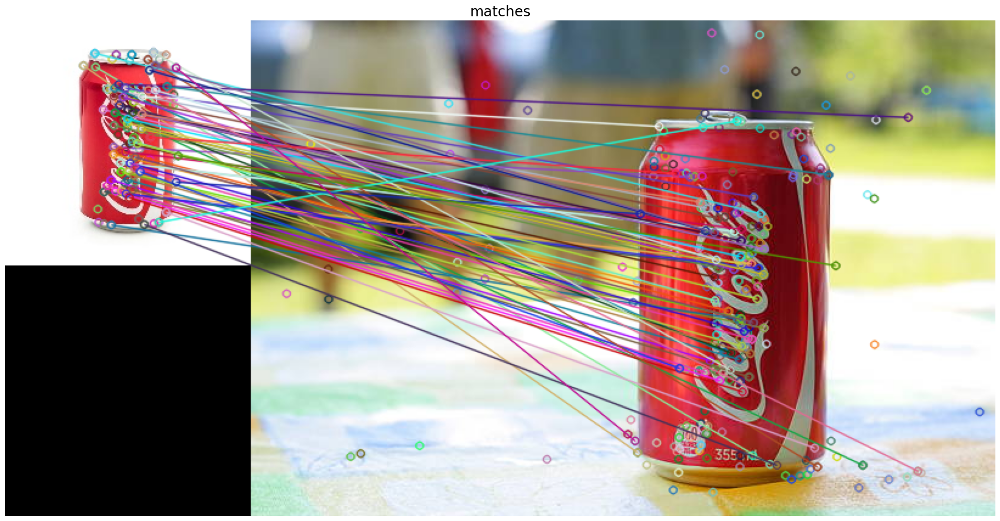

In [4]:
matcher = cv2.BFMatcher_create(cv2.NORM_L2, crossCheck=True)
matches = matcher.match(coke_desc, table_desc)

show_matches = cv2.drawMatches(coke, coke_kp, table, table_kp, matches, None)

print("Maches found: ", len(matches))
display_images([show_matches], ['matches'])

## FLANN

Maches found:  116


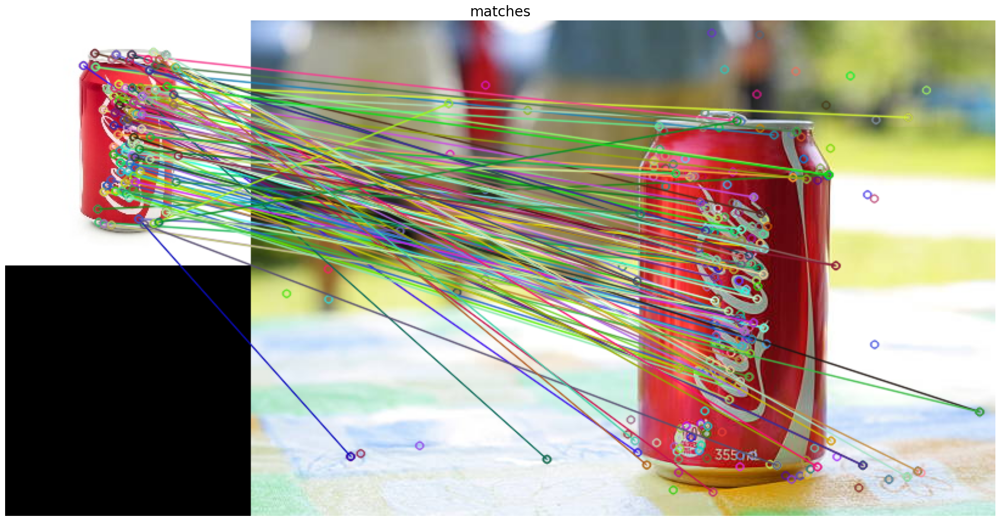

In [5]:
flann = cv2.FlannBasedMatcher_create()
matches2 = flann.match(coke_desc, table_desc)
show_matches3 = cv2.drawMatches(coke, coke_kp, table, table_kp, matches2, None)
print("Maches found: ", len(matches2))
display_images([show_matches3], ['matches'])


##### Zadanie 3b

Powtórz detekcję z użyciem k-najlepszych wyników (dla niewielkiego k, np. 2 lub 3). Zaproponuj prosty sposób wykrywania sytuacji, w których jeden punkt jest podobnie bliski innym i użyj go do odfiltrowania wyników, tak aby pozostawić te bardziej unikatowe dopasowania. *Czy unikatowe znaczy dobre?*

In [6]:
knn_matcher = cv2.BFMatcher_create()
best_knn_match = knn_matcher.knnMatch(coke_desc, table_desc, k=2)

Maches found:  116


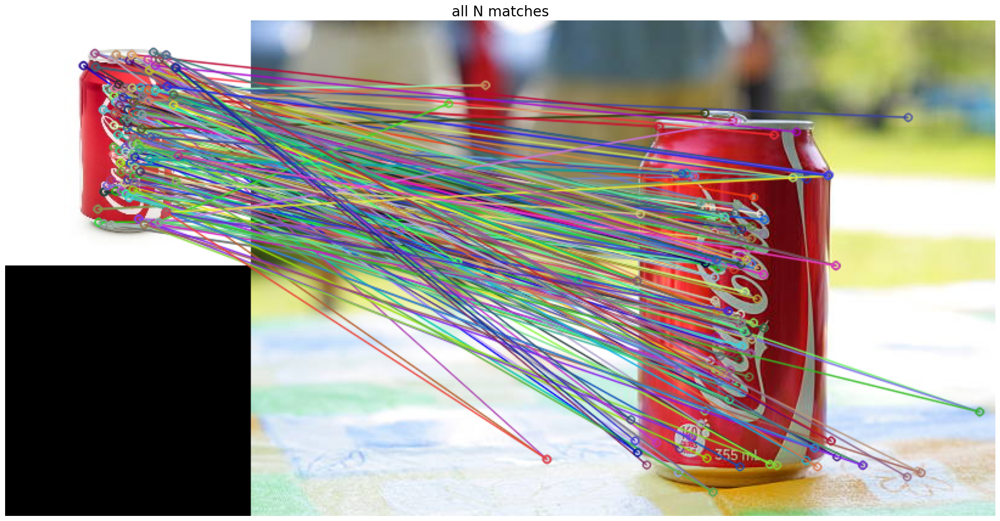

In [7]:
# draw matches
show_matches = cv2.drawMatchesKnn(coke, coke_kp, table, table_kp, best_knn_match, None,
                                  flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
print("Maches found: ", len(best_knn_match))
display_images([show_matches], ['all N matches'])

Maches found:  13


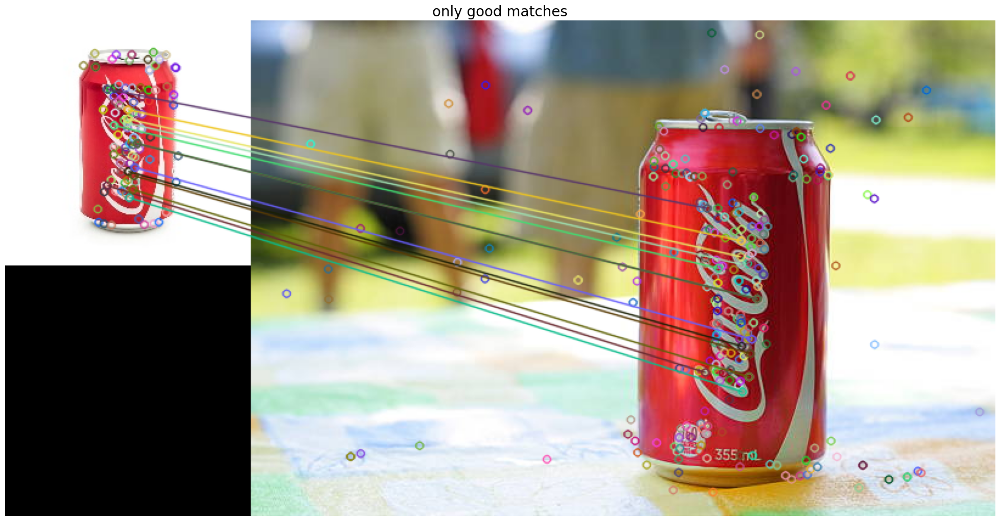

In [8]:
good_matches = []
for m, n in best_knn_match:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

show_matches = cv2.drawMatches(coke, coke_kp, table, table_kp, good_matches, None)
print("Maches found: ", len(good_matches))
display_images([show_matches], ['only good matches'])

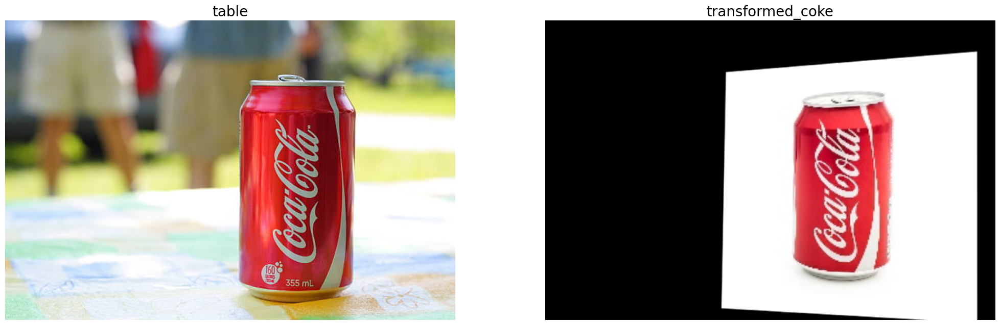

In [9]:
src_pts = np.float32([coke_kp[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
dst_pts = np.float32([table_kp[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

transformed_coke = cv2.warpPerspective(coke, M, (table.shape[1], table.shape[0]))
display_images([table, transformed_coke], ['table', 'transformed_coke'])




#### Zadanie 4

Wykonaj serię zdjęć dowolnej wybranej przez siebie **statycznej** sceny. Może to być niemal dowolny widok o dowolnej skali: panorama miasta, swojego pokoju, powierzchni biurka - ważne, by pozyskane obrazy (1) zawierały jakieś punkty charakterystyczne oraz (2) spełniały założenia transformacji perspektywicznej.

Wykonaj 4-5 zdjęć, spośród których pierwsze (nazwij je `base`) niech przedstawia \"główny\" widok sceny, a pozostałe (o nazwie `offset_{index}`) niech cechują się coraz większym przesunięciem kamery względem `base`. Proponowane różnice:
* nieznaczne przesunięcie (o połowę-2/3 szerokości klatki),
* większe przesunięcie (o 3/4-4/5 szerokości),
* przesunięcie z rotacją w osi kamery,
* (jeśli to możliwe) przybliżenie/oddalenie kamery.

Celem zadania będzie przetestowanie możliwości detekcji i parowania punktów kluczowych w celu łączenia (_stitching_) obrazów. Wykorzystaj algorytmy opracowane do realizacji zadania 3 (zwłaszcza 3c) w celu przekształcania obrazów `offset_x` do geometrii `base`. Upewnij się, że wymiary tworzonych w ten sposób obrazów są wystarczające do zmieszczenia obu składowych.

*Czy każdą parę `offset_i`-`base` udało się połączyć? Jaka jest jakość dopasowania? Jeśli dla którejś pary algorytm zawiódł - dlaczego?*

In [10]:
path = 'photos'
path = os.listdir(path)
path.sort()

In [11]:
def imread_transform(img, path):
    img = cv2.imread(f'{path}/' + img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img = cv2.resize(img, (int(img.shape[1] * 0.5), int(img.shape[0] * 0.5)))
    return img

In [12]:
move_big = []
for im in ['big1.jpeg',
           'big2.jpeg']:
    move_big.append(imread_transform(im, 'photos'))

In [13]:
move = []
for im in ['up1.jpeg',
           'up2.jpeg']:
    move.append(imread_transform(im, 'photos'))

In [14]:
rotation = []
for im in ['rotacja1.jpeg',
           'rotacja2.jpeg']:
    rotation.append(imread_transform(im, 'photos'))

In [15]:
zoom = []
for im in ['oddalenie1.jpeg',
           'oddalenie2.jpeg']:
    zoom.append(imread_transform(im, 'photos'))

In [16]:
def image_stitching(imgs, transformed):
    result = np.zeros_like(imgs[1])
    result[0:imgs[0].shape[0], 0:imgs[0].shape[1]] = transformed
    result[0:imgs[1].shape[0], 0:imgs[1].shape[1]] += imgs[1]
    display_images([imgs[0], imgs[1]], ['img1', 'img2'], figsize=(10, 10))
    display_images([result], ['result'], figsize=(10, 10))

# MOVE_BIG

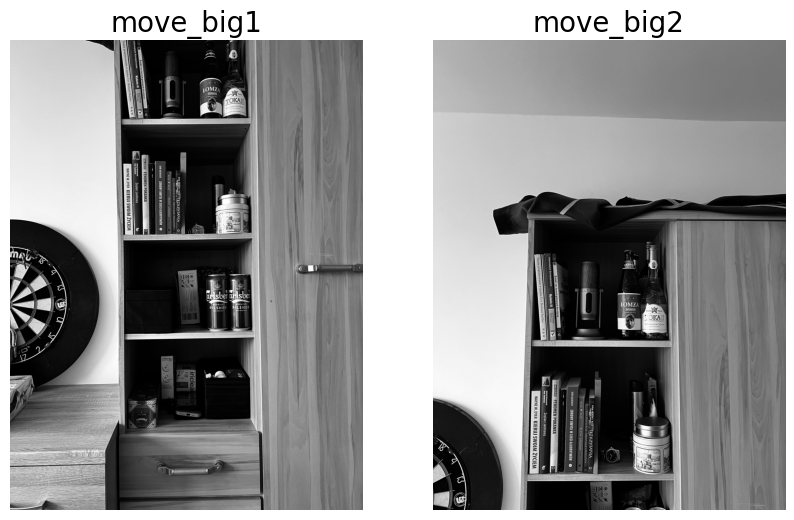

Maches found:  1375


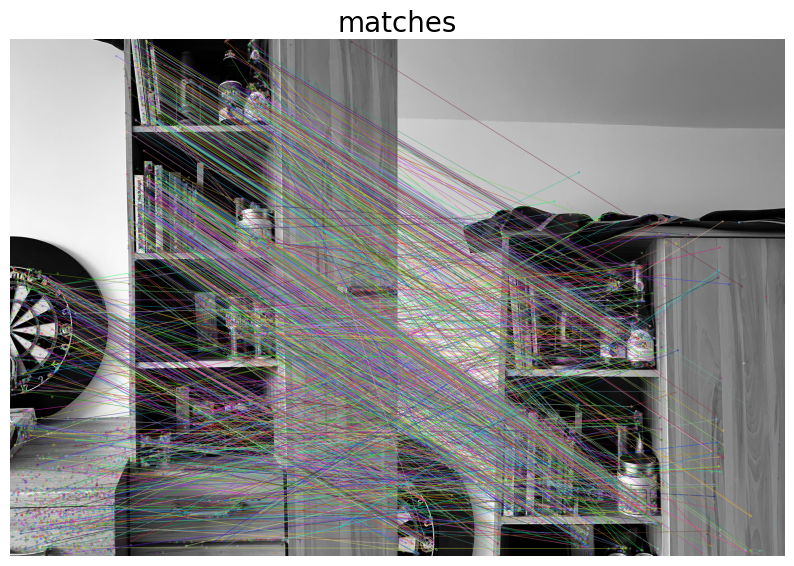

Maches found:  215


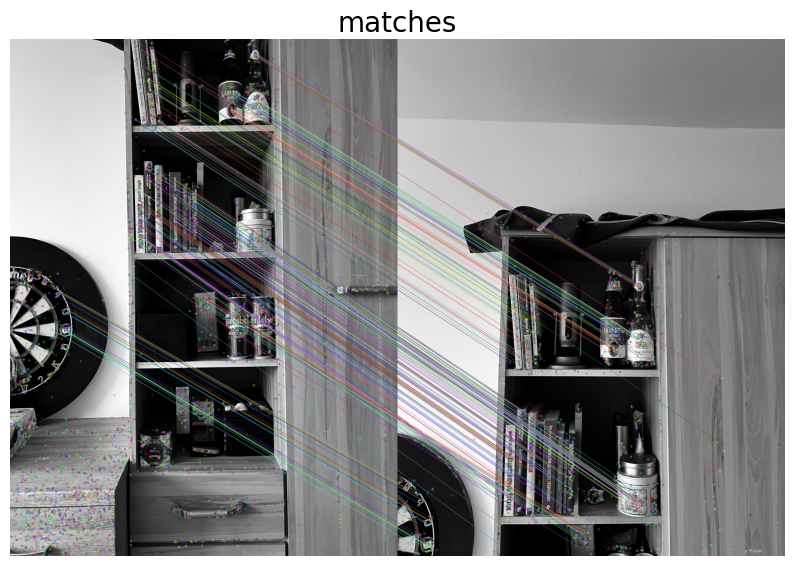

In [17]:
display_images(move_big, ['move_big1', 'move_big2'], figsize=(10, 10))
sift = cv2.SIFT_create()
move_big_kp1, move_big_desc1 = sift.detectAndCompute(move_big[0], None)
move_big_kp2, move_big_desc2 = sift.detectAndCompute(move_big[1], None)

matcher = cv2.BFMatcher_create(cv2.NORM_L2, crossCheck=True)
matches = matcher.match(move_big_desc1, move_big_desc2)
show_matches = cv2.drawMatches(move_big[0], move_big_kp1, move_big[1], move_big_kp2, matches, None)
print("Maches found: ", len(matches))
display_images([show_matches], ['matches'], figsize=(10, 10))

knn_matcher = cv2.BFMatcher_create()
best_knn_match = knn_matcher.knnMatch(move_big_desc1, move_big_desc2, k=2)
good_matches = []
for m, n in best_knn_match:
    if m.distance < 0.4 * n.distance:
        good_matches.append(m)
show_matches = cv2.drawMatches(move_big[0], move_big_kp1, move_big[1], move_big_kp2, good_matches, None)
print("Maches found: ", len(good_matches))
display_images([show_matches], ['matches'], figsize=(10, 10))

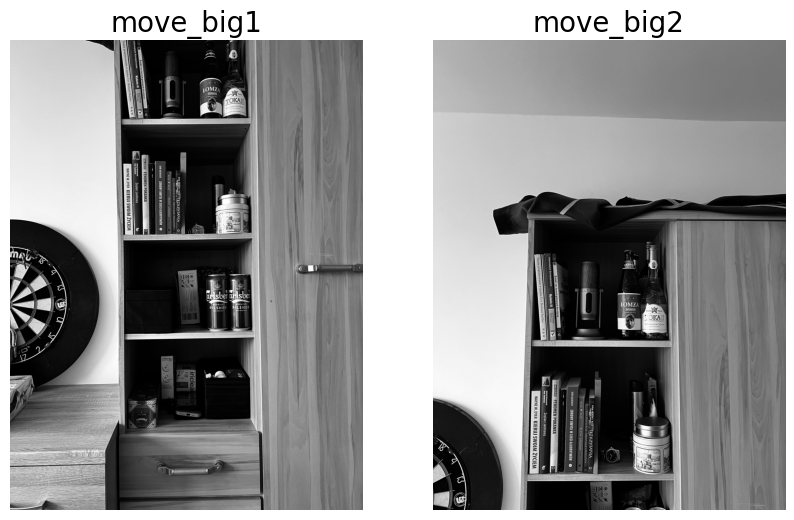

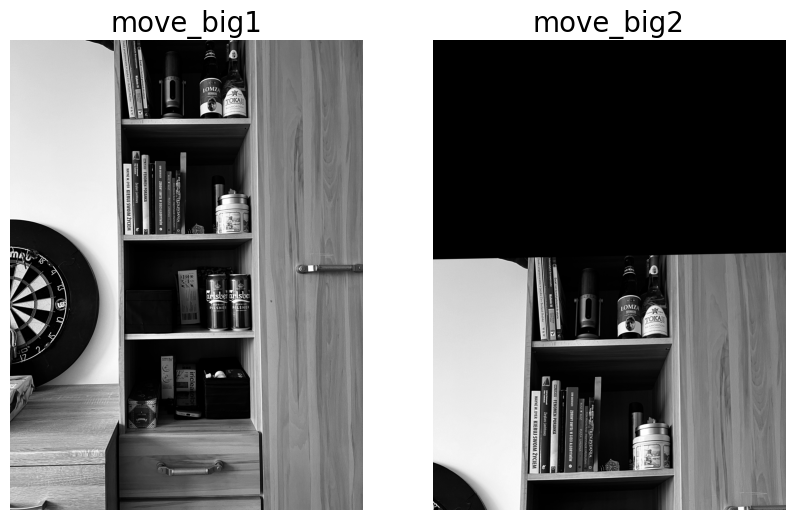

In [18]:
src_pts = np.float32([move_big_kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
dst_pts = np.float32([move_big_kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

transformed = cv2.warpPerspective(move_big[0], M, (move_big[1].shape[1], move_big[1].shape[0]))
display_images(move_big, ['move_big1', 'move_big2'], figsize=(10, 10))
display_images([move_big[0], transformed], ['move_big1', 'move_big2'], figsize=(10, 10))

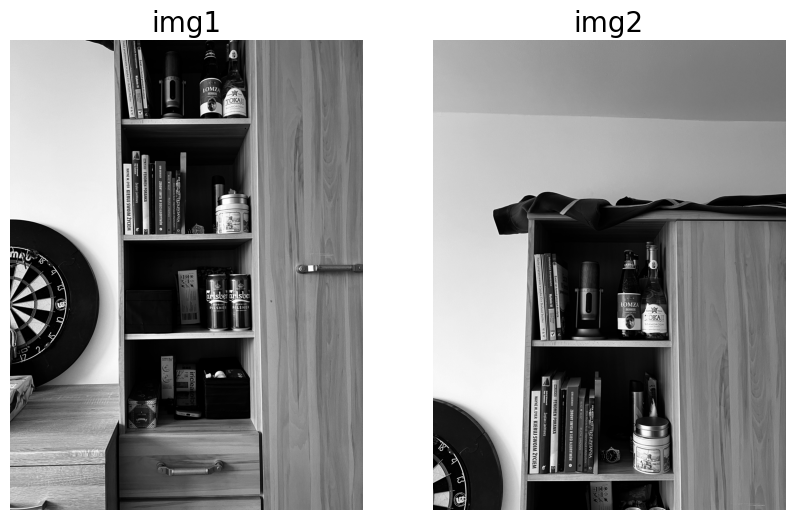

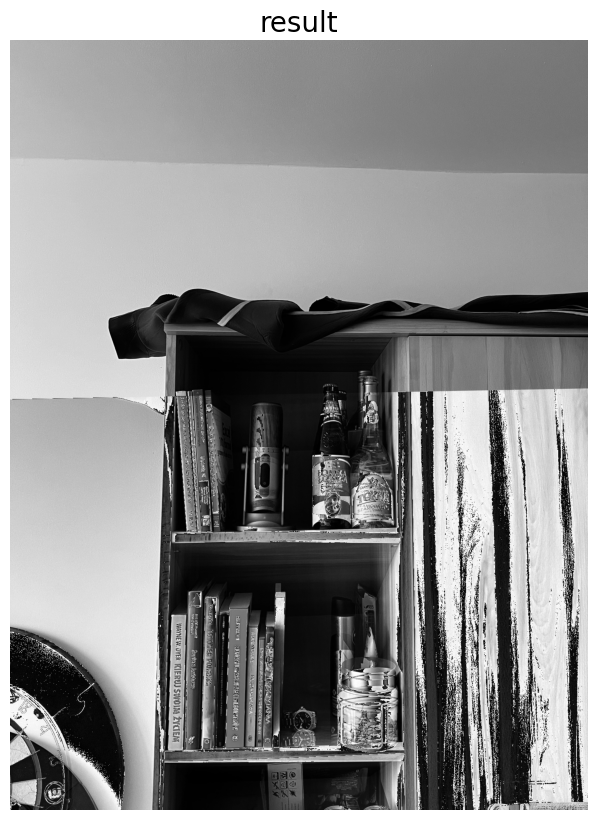

In [19]:
image_stitching(move_big, transformed)

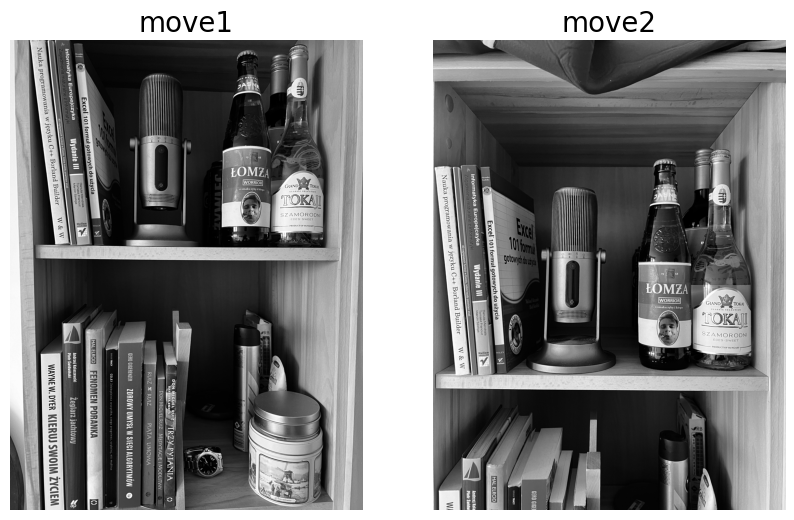

Maches found:  2607


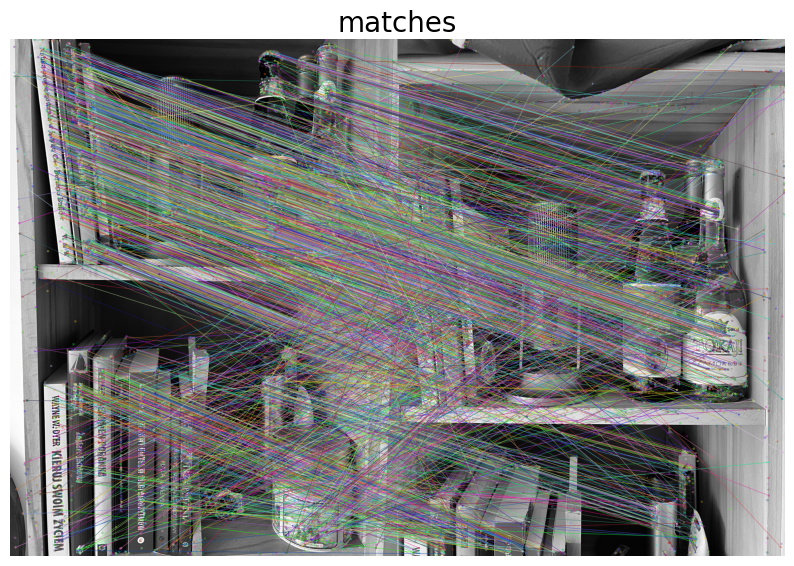

Maches found:  490


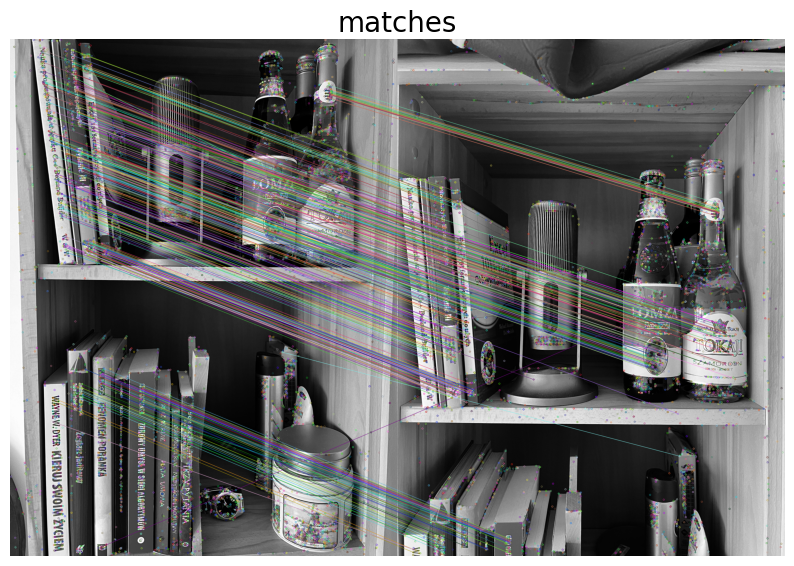

In [20]:
display_images(move, ['move1', 'move2'], figsize=(10, 10))
sift = cv2.SIFT_create()
move_kp1, move_desc1 = sift.detectAndCompute(move[0], None)
move_kp2, move_desc2 = sift.detectAndCompute(move[1], None)

matcher = cv2.BFMatcher_create(cv2.NORM_L2, crossCheck=True)
matches = matcher.match(move_desc1, move_desc2)
show_matches = cv2.drawMatches(move[0], move_kp1, move[1], move_kp2, matches, None)
print("Maches found: ", len(matches))
display_images([show_matches], ['matches'], figsize=(10, 10))

knn_matcher = cv2.BFMatcher_create()
best_knn_match = knn_matcher.knnMatch(move_desc1, move_desc2, k=2)
good_matches = []
for m, n in best_knn_match:
    if m.distance < 0.4 * n.distance:
        good_matches.append(m)
show_matches = cv2.drawMatches(move[0], move_kp1, move[1], move_kp2, good_matches, None)
print("Maches found: ", len(good_matches))
display_images([show_matches], ['matches'], figsize=(10, 10))

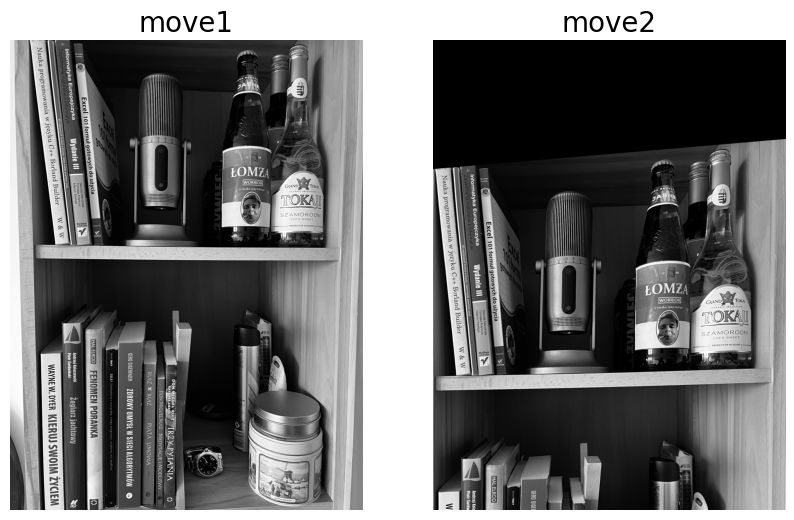

In [21]:
src_pts = np.float32([move_kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
dst_pts = np.float32([move_kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

transformed = cv2.warpPerspective(move[0], M, (move[1].shape[1], move[1].shape[0]))
# display_images(move, ['move1', 'move2'], figsize=(10, 10))
display_images([move[0], transformed], ['move1', 'move2'], figsize=(10, 10))

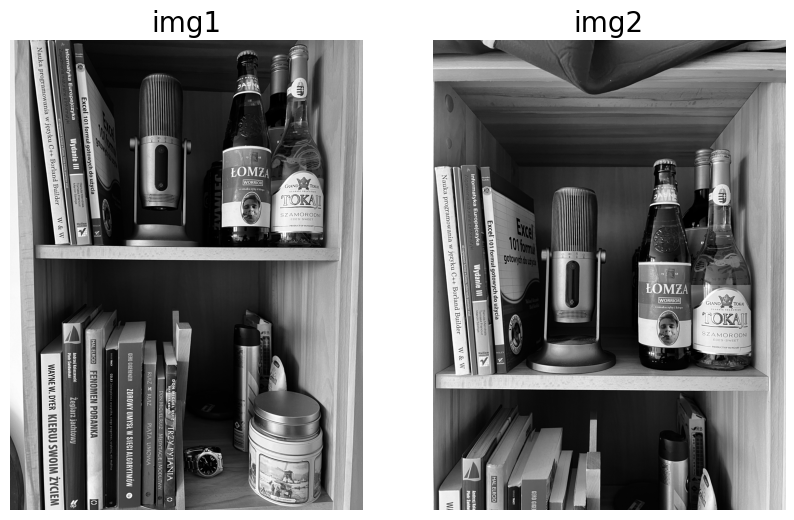

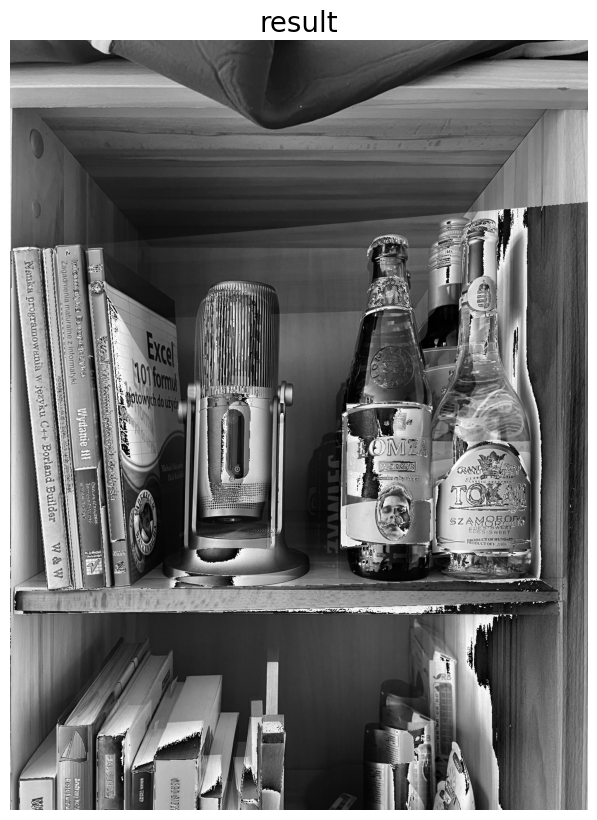

In [22]:
image_stitching(move, transformed)

# ROTATION

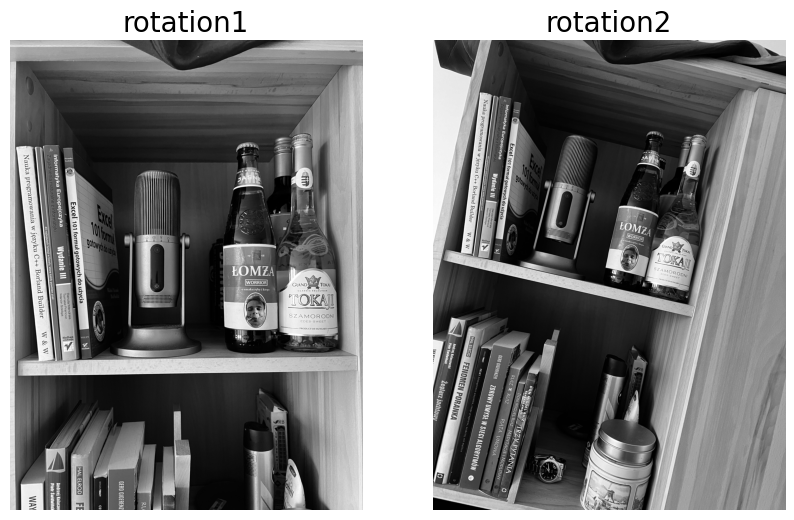

Maches found:  2509


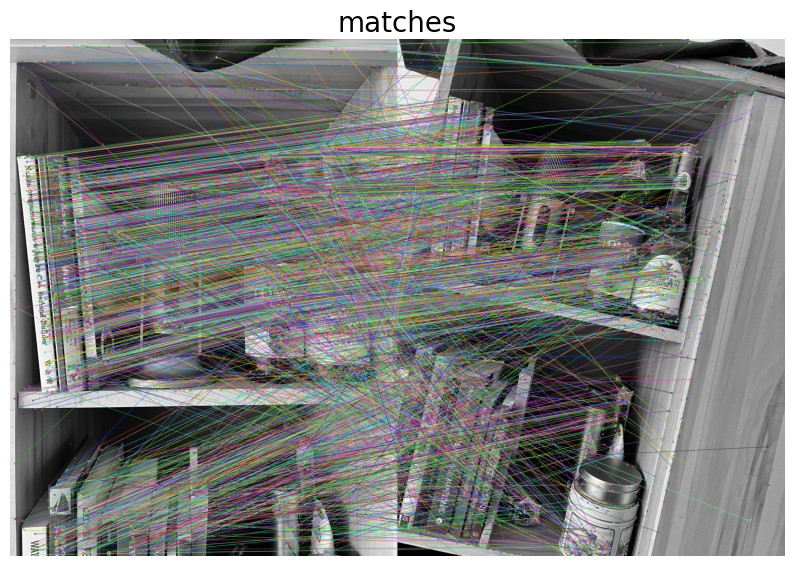

Maches found:  543


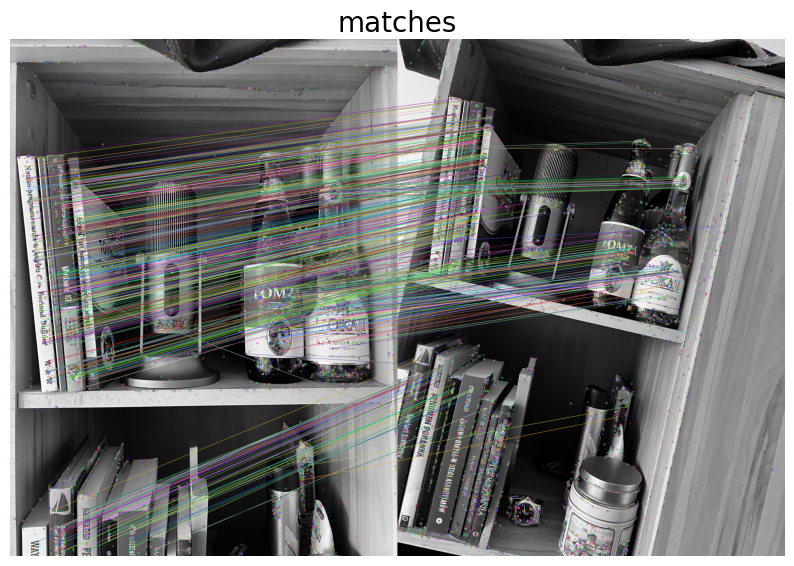

In [23]:
display_images(rotation, ['rotation1', 'rotation2'], figsize=(10, 10))
sift = cv2.SIFT_create()
rotation_kp1, rotation_desc1 = sift.detectAndCompute(rotation[0], None)
rotation_kp2, rotation_desc2 = sift.detectAndCompute(rotation[1], None)

matcher = cv2.BFMatcher_create(cv2.NORM_L2, crossCheck=True)
matches = matcher.match(rotation_desc1, rotation_desc2)
show_matches = cv2.drawMatches(rotation[0], rotation_kp1, rotation[1], rotation_kp2, matches, None)
print("Maches found: ", len(matches))
display_images([show_matches], ['matches'], figsize=(10, 10))

knn_matcher = cv2.BFMatcher_create()
best_knn_match = knn_matcher.knnMatch(rotation_desc1, rotation_desc2, k=2)
good_matches = []
for m, n in best_knn_match:
    if m.distance < 0.4 * n.distance:
        good_matches.append(m)
show_matches = cv2.drawMatches(rotation[0], rotation_kp1, rotation[1], rotation_kp2, good_matches, None)
print("Maches found: ", len(good_matches))
display_images([show_matches], ['matches'], figsize=(10, 10))

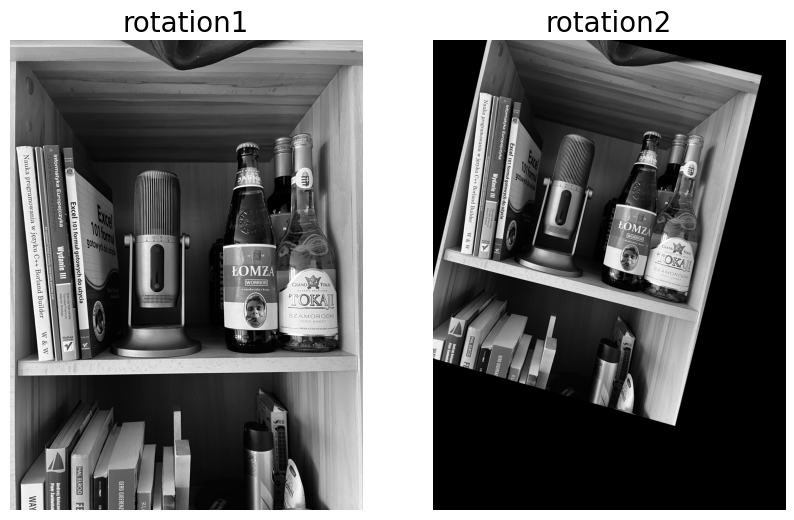

In [24]:
src_pts = np.float32([rotation_kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
dst_pts = np.float32([rotation_kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

transformed = cv2.warpPerspective(rotation[0], M, (rotation[1].shape[1], rotation[1].shape[0]))
# display_images(rotation, ['rotation1', 'rotation2'], figsize=(10, 10))
display_images([rotation[0], transformed], ['rotation1', 'rotation2'], figsize=(10, 10))

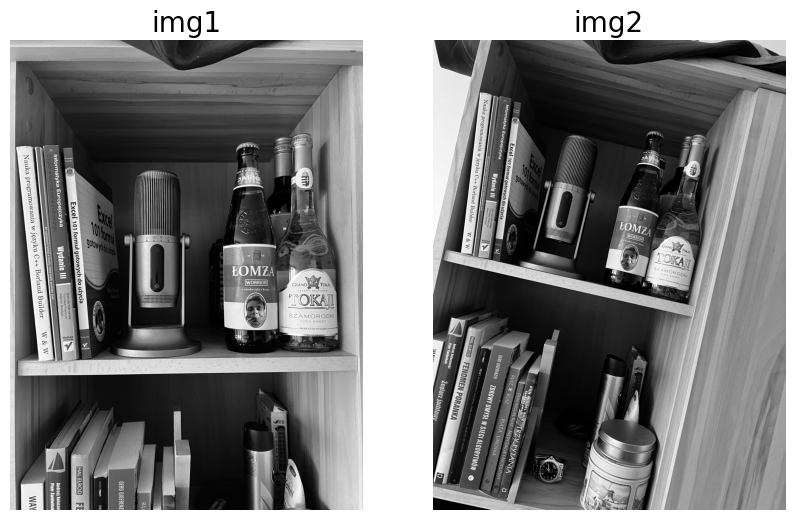

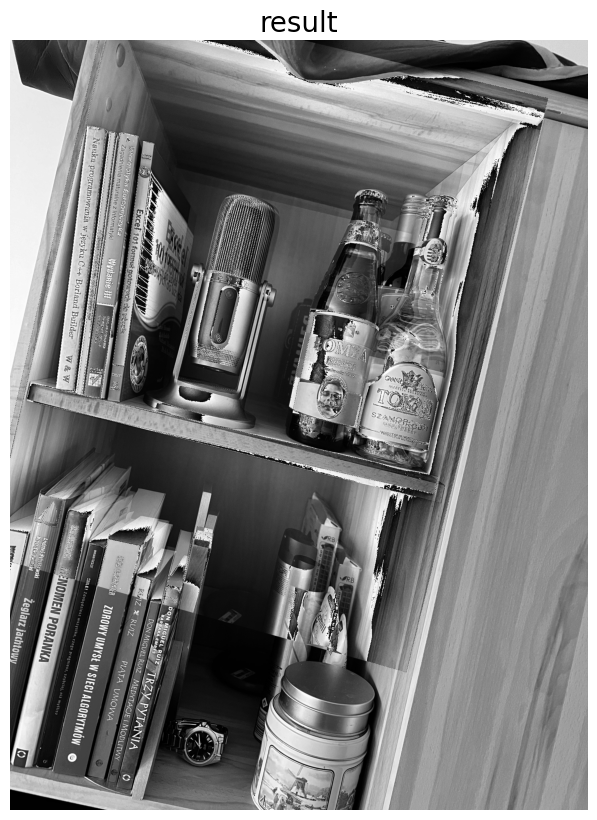

In [25]:
image_stitching(rotation, transformed)

# ZOOM

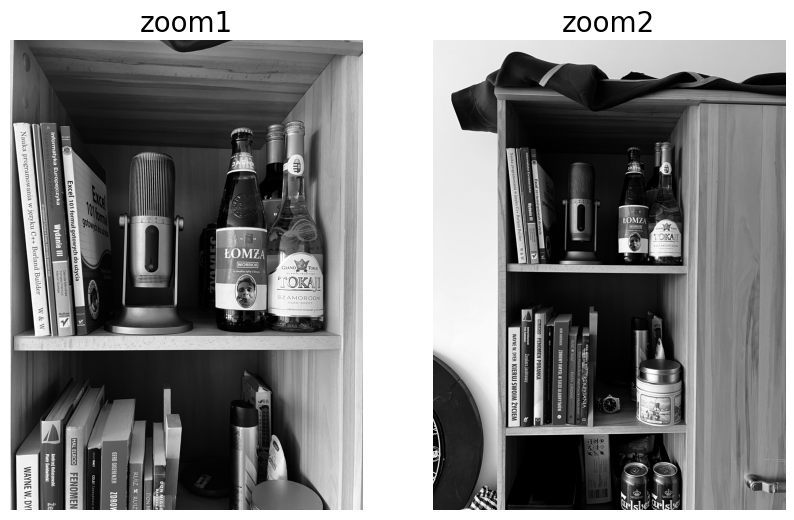

Maches found:  1806


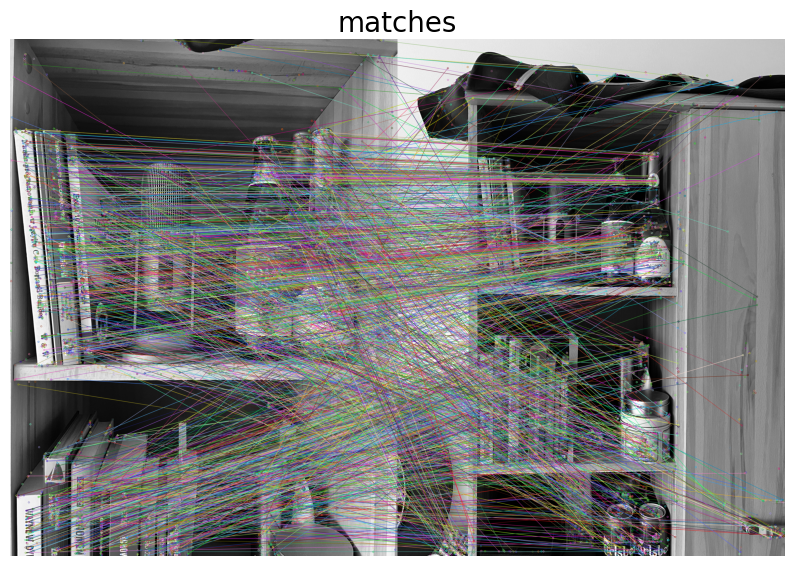

Maches found:  192


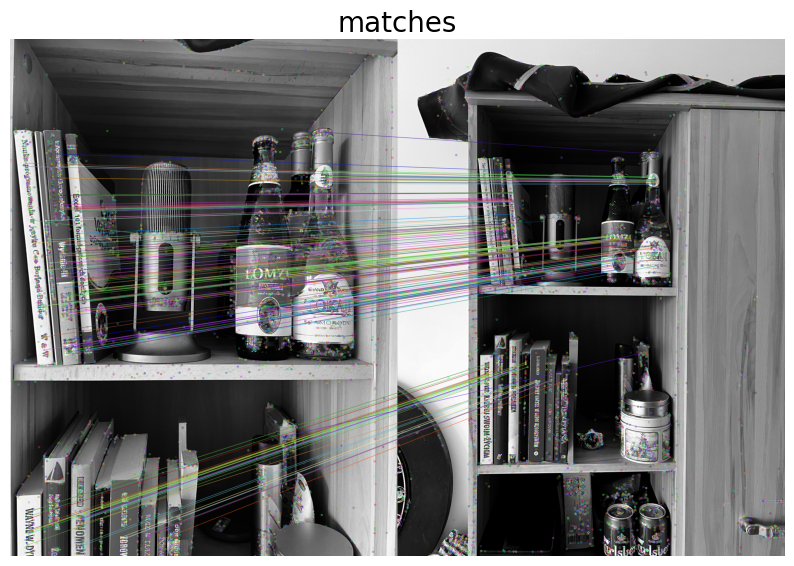

In [26]:
display_images(zoom, ['zoom1', 'zoom2'], figsize=(10, 10))
sift = cv2.SIFT_create()
zoom_kp1, zoom_desc1 = sift.detectAndCompute(zoom[0], None)
zoom_kp2, zoom_desc2 = sift.detectAndCompute(zoom[1], None)

matcher = cv2.BFMatcher_create(cv2.NORM_L2, crossCheck=True)
matches = matcher.match(zoom_desc1, zoom_desc2)
show_matches = cv2.drawMatches(zoom[0], zoom_kp1, zoom[1], zoom_kp2, matches, None)
print("Maches found: ", len(matches))
display_images([show_matches], ['matches'], figsize=(10, 10))

knn_matcher = cv2.BFMatcher_create()
best_knn_match = knn_matcher.knnMatch(zoom_desc1, zoom_desc2, k=2)
good_matches = []
for m, n in best_knn_match:
    if m.distance < 0.4 * n.distance:
        good_matches.append(m)
show_matches = cv2.drawMatches(zoom[0], zoom_kp1, zoom[1], zoom_kp2, good_matches, None)
print("Maches found: ", len(good_matches))
display_images([show_matches], ['matches'], figsize=(10, 10))

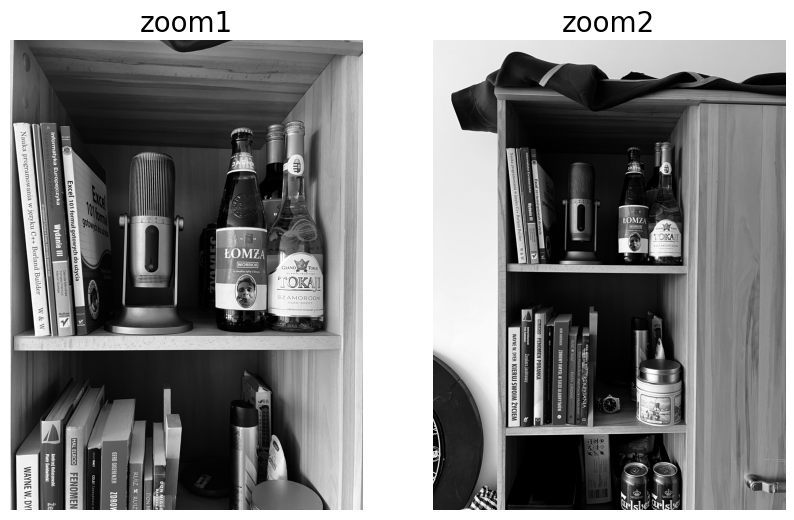

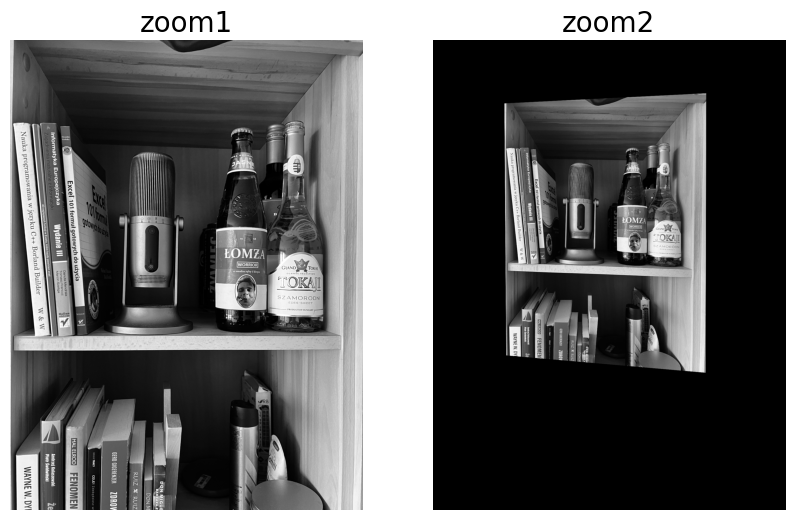

In [27]:
src_pts = np.float32([zoom_kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
dst_pts = np.float32([zoom_kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

transformed = cv2.warpPerspective(zoom[0], M, (zoom[1].shape[1], zoom[1].shape[0]))
display_images(zoom, ['zoom1', 'zoom2'], figsize=(10, 10))
display_images([zoom[0], transformed], ['zoom1', 'zoom2'], figsize=(10, 10))

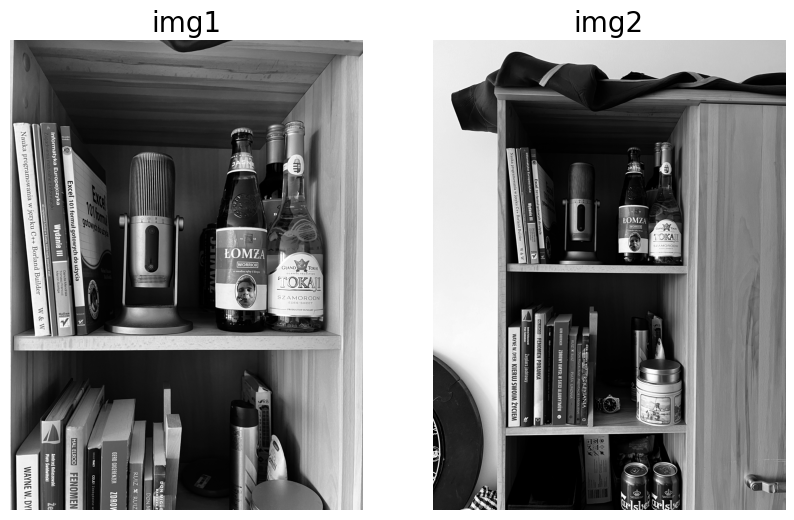

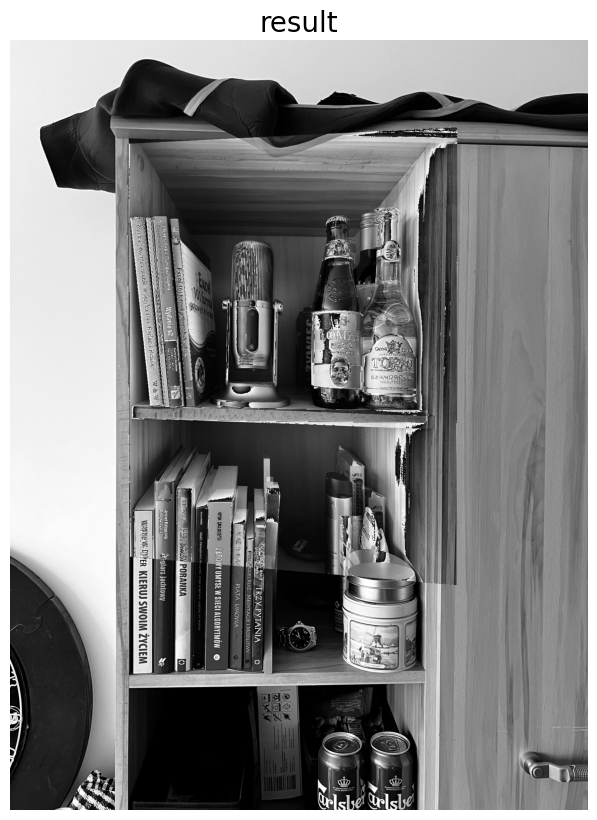

In [28]:
image_stitching(zoom, transformed)